<div align="center">
<a href="https://vbti.nl"><img src="https://docs.google.com/uc?export=download&id=1DdCGllL51O5wBuiI0rwygofKx3YIDPHX" width="400"></a>
</div>

# The Perceptron
The perceptron is a fundamental building block of many deep learning techniques. The operation of a perceptron is simple, therefore we can study it well. That is exactly what we are going to do in this chapter.

## Learning objectives

- Understand the mathematical model of a perceptron.
- Understand the Perceptron training rule.
- Understand the Perceptron delta rule.
- Train a perceptron on a given dataste and evaluate its performance.


# Introduction

*Deep Learning* is a machine learning technique that has received a lot of attention lately. Due to a combination of data, hardware, and software developments, this technology makes it possible to build intelligent applications that are not possible with traditional methods. Think of self-driving cars, accurate speech recognition, object recognition in images, chatbots, video analysis, and more.

When we talk about deep learning, it is often about so-called *artificial neural networks*. An artificial neural network, or neural network for short, is a machine learning technique inspired by the functioning of a brain. The basic building block of the brain is a *neuron*. A neuron consists of a cell body that can receive signals from other neurons via so-called dendrites. During its lifetime, a neuron can form connections to other neurons. The signals are, in a way, added up by the cell body. Once enough signals have been received, a neuron itself sends a signal to other neurons via the so-called *axon*. You can see an animated explanation of this operation in the video below.

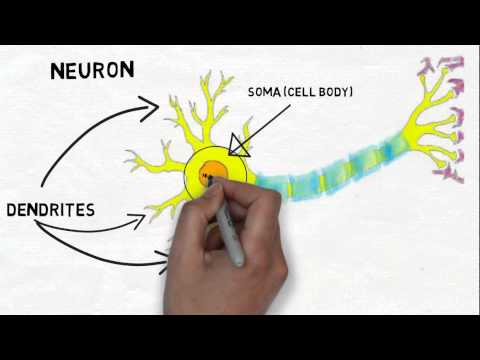

In [1]:
from IPython.display import YouTubeVideo
YouTubeVideo('6qS83wD29PY', width=600, height=400)

# Perceptron

<div align="center">
<img src="https://drive.google.com/uc?id=1Jn568URocBZqlzb103y_aJ7laoj4MTdP" width="500"></br>
Neuron. Source: https://en.wikipedia.org/wiki/Neuron
</div>
</br>

In 1943 the neurophysiologist Warren McCulloch and mathematician Walter Pitts developed a simple mathematical model of a neuron. This model is called the *perceptron* model. In the perceptron model, the functioning of a cell body is modeled in two steps. The first step is to add up all incoming signals. With biological neurons, every signal that comes in via a dendrite via so-called neurotransmitters has a different effect on the cell body. Some neurotransmitters cause a cell body to send out a signal faster. Others ensure that a cell body is properly inhibited in sending a signal. This is modeled in the perceptron model by multiplying each entry $x_i$ by a weight $w_i$. A weight can have a positive or negative value.

The second step in the perceptron model is the so-called *activation function*. A biological neuron will only send a signal if the sum of the incoming signals exceeds a certain threshold level. Ultimately, the perceptron can be described with the following **perceptron equation**:

$$
y = f(z)
$$

$$
z = w_1 \cdot x_1 + w_2 \cdot x_2 + \ldots + w_n \cdot x_n + b = \mathbf {w} ^ T \mathbf {x} + b
$$

Here $z$ is the net result of all incoming signals, $f$ the activation function and $y$ the output of the perceptron.

<div align="center">
<img src="https://drive.google.com/uc?id=1pU-faP9Vxxx5RKIDX_LUPihwSK-njN81" width="500">
</div>

In [1]:
# import standart libraries
%run default_setup.py
%load_ext autoreload
%autoreload 2
%matplotlib inline

np.random.seed(2020)

Loaded numpy 1.19.2 as np.
Loaded pandas 1.1.3 as pd
Loaded matplotlib.pyplot 3.3.2 as plt
Loaded seaborn 0.11.0 as sns
Loaded tensorflow as tf 2.1.0.


The activation function of the original perceptron is a threshold function:
$$
f (z) = \begin {cases}
    0 & \text {if z < 0} \\
    1 & \text {else}
\end{cases}
$$

The perceptron equation can be easily implemented in Numpy.

In [2]:
import numpy as np

def threshold_fn(z):
    return (z>=0).astype(float)

def perceptron(X, W, b, f=threshold_fn):
    # Hint: use np.dot() method for dot notation
    #---YOUR CODE HERE---#
    result = ...
    return result

In the next cell you can test the ouput of the perceptron. With these weights and bias the output should be `1.0`. The next cell should run with no exceptions if that is the case.

In [3]:
# initialize weight vector and bias of perceptron
W0 = np.asarray([1, 1])
b0 = 1

example_data_point = np.asarray([1, 2])
example_output = perceptron(example_data_point, W0, b0)
print('Output of the Perceptron:', example_output)
assert example_output == 1.0

Output of the Perceptron: 1.0


# Hyperplane

Neural networks are, to a large extent, 'black box' models. Although they can learn complex relationships in data, it is difficult for a user to estimate what exactly a neural network has learned. Because a perceptron is still relatively simple, we can study it well to develop an intuition about how neural networks work.

Different interpretations of the perceptron equation are possible. One interpretation is that of a [*hyperplane*](https://en.wikipedia.org/wiki/Hyperplane). Here the entries $ x_i $ are the elements (features) of an n-dimensional data vector $ \mathbf {x} $. The weights $ w_i $ are the elements of a weights vector $ \mathbf {w} $. The equation

$$
w_1 \cdot x_1 + w_2 \cdot x_2 + \ldots + w_n \cdot x_n + b = 0
$$

describes a hyperplane that splits the n-dimensional data space into two. Note that sometimes this equation is written in vector form as 

$$
\mathbf {x} \cdot \mathbf {w} + b = 0
$$

$\mathbf {x} \cdot \mathbf {w}$ - is a [dot product](https://en.wikipedia.org/wiki/Dot_product).

If $ \mathbf {x}  \cdot \mathbf {w} + b > 0 $ for a data point $ \mathbf {x} $, then this data point belongs to one class. If $ \mathbf {x}  \cdot \mathbf {w} + b <0 $ then the data point belongs to the other class.

To better understand this, we are going to plot a few 2-dimensional hyperplanes. In a 2-dimensional space (a plane), a hyperplane is a line. With a line, you can split a plane in two. We will have a perceptron with two weights $\mathbf{w} = [w_1, w_2]$ for two dimensions $x_1$ and $x_2$. The activation function used will be a threshold function. We can say that data-points on one side ($y=0$) belong to one class, while points on the other side ($y=1$) belong to a different class. Perfect for binary classification.

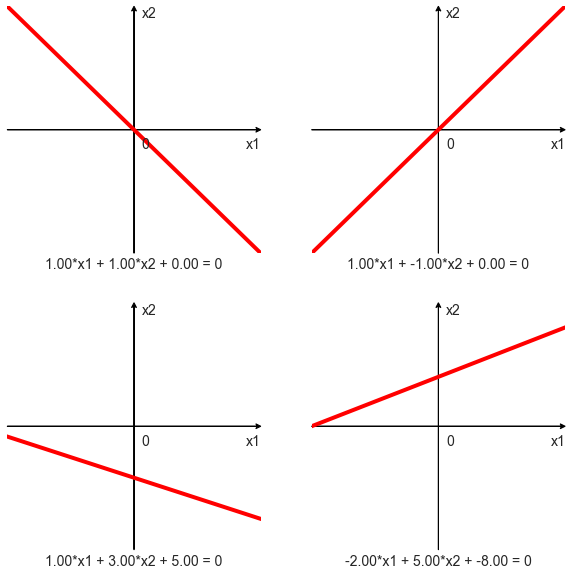

In [4]:
import matplotlib.pyplot as plt
from support import plot_hyperplane

# plot some random hyperplanes
fig, ax = plt.subplots(2, 2, figsize=(10,10))

# use support function to plot hyperplane
plot_hyperplane(ax[0,0], w1=1., w2=1., b=0., label=True)
plot_hyperplane(ax[0,1], w1=1., w2=-1., b=0., label=True)
plot_hyperplane(ax[1,0], w1=1., w2=3., b=5., label=True)
plot_hyperplane(ax[1,1], w1=-2., w2=5., b=-8., label=True)

# Perceptron for classification

One of the applications of a perceptron is classification. A dataset with two classes can be learned well with a perceptron, but only if the classes are linearly separable. After all, a linear separation means that you can divide the data space into two with a single line. Something that a perceptron can do!

The main challenge is finding values for the weights and bias so that the perceptron divides the dataspace correctly. That is, given an input $ (x_1, x_2) $ the perceptron will predict the right class $y$. Perceptron Training Rule can be used to find these values (see [Machine Learning, Tom Mitchel, 1997](http://www.cs.cmu.edu/~tom/mlbook.html)). 

## Perceptron Training rule
One way to find good values for the weight vector and bias is to start with random values and iteratively adjust the values, that is:

$$
\mathbf{w}_i \leftarrow \mathbf{w}_i + \Delta \mathbf{w}_i
$$
$$
b_i \leftarrow b_i + \Delta b_i
$$

During each iteration a data point $(\mathbf{x}, y)$ from the dataset $D$ is taken and a prediction $\hat{y} = f(\mathbf {x} \cdot \mathbf {w} + b )$ is made using the perceptron equation. Whenever the predicted value $\hat{y}$ is unequal to the *target* (real) value $y$, the weight vector and bias are adjusted. The Perceptron Training Rule uses the following formula to udpate its values:

$$
\Delta \mathbf{w}_i = \eta (y - \hat{y}) * \mathbf{x}_i
$$
$$
\Delta b_i = \eta (y - \hat{y}) 
$$

Here, $\eta$ is a small and positive constant called the *learning rate*. Its role is to adjust the amount the weight vector and bias values are adjusted. The term $y - \hat{y}$ is called the *prediction error*. Notice that if the *prediced* and *target* values are the same, the deltas $\Delta \mathbf{w}_i$ and $\Delta b_i$ equal to zero.

Intuitively this learning rule can be understood by looking at three situations:

- $y - \hat{y}$ = 0 : the prediction error is zero and thus the weight vector and bias need no adjustments.
- $y - \hat{y}$ = 1 : the target value is 1 but the perceptron predicts 0, therefore the weight vector need to be increased for positive and decreased for negative $\mathbf{x}$ values.
- $y - \hat{y}$ = -1 : the target value is 0 but the perceptron predicts 1, therefore the weight vector need to be decreased for positive and increased for negative $\mathbf{x}$ values.

The perceptron training rule can be implemented in NumPy in a single line of code.

To gain better insight into the perceptron training rule, we will simulate how the hyperplane of a perceptron changes during learning. First we create a dataset.

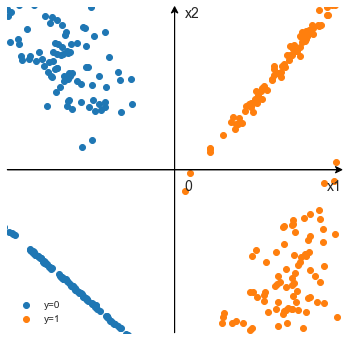

In [49]:
# import some modules
from sklearn import datasets
from support import plot_dataset_2d

# generate and plot dataset
X, y = datasets.make_classification(400, n_features=2, n_redundant=0, class_sep=2)
plot_dataset_2d(X, y);

In [50]:
# binary accuracy rule
def binary_accuracy(y_true, y_pred):
    accuracy = np.mean(1 - np.abs(y_pred.flatten() - y_true.flatten()))
    return accuracy

# DIY: Implement the perceptron training rule
def perceptron_training_rule(W, b, y, y_pred, x, learning_rate):
    #---YOUR CODE HERE---#
    # Hint: use equationsd defined before
    W = ...
    b = ...
    return W, b

# initialize weight vector and bias of perceptron
W0 = (-0.5 + np.random.random(size=X.shape[1]))
b0 = (-0.5 + np.random.random(1))

learning_rate = 0.01

In the next cell you can test whether your learning rule is working. If the accuracy of the perceptron is higher than 50% this means that we outperform the random guess and that your rule is working. **Note:** that depending on your learning rate the rule might not converge at all. You can rerun the cell and check if the accuracy is improving. You can think about each re-run an *epoch* - iteration over your whole training set.

In [51]:
# permute the ids of the dataset
sample_idxs = np.random.permutation(X.shape[0])

# iterate over each element
for idx in sample_idxs:
    # select a random point
    x = X[idx,:]            

    # predict output
    y_pred = perceptron(x, W0, b0, threshold_fn)

    # update weights
    W0, b0 = perceptron_training_rule(W0, b0, y[idx], y_pred, x, learning_rate)

# Make prediction on the whole dataset
final_y_pred = perceptron(X, W0, b0, threshold_fn)    

# If the accuracy is above 50 percent the rule is working
print("Final Accuracy: {}%".format(binary_accuracy(y, final_y_pred) * 100))

# you can re-run this cell if it did not converge

Final Accuracy: 99.0%


## Learning Rule Annimation

Next, we animate the perceptron training rule. In the animation, the data points of the dataset and the hyperplane (a line for 2-dimensional data) are drawn. At each iteration, a data point is selected and marked by a red dot. The perceptron parameters are adjusted using the Perceptron Training Rule.

In [52]:
import matplotlib.animation as animation
import matplotlib.pyplot as plt
from IPython.display import HTML

def animate_perceptron_training_rule(X, y, W0, b0, learning_rate=0.01, Nsteps=20, Nskip=1, figsize=(6, 6), add_feature=None):
    """Create animation of perrceptron learning."""    
    global W, b
    
    fig, ax = plt.subplots(figsize=figsize)
    plt.close() # remove additional plot shown in Jupyter

    # calculate min/max value of data for plotting
    x1_min, x2_min = -np.abs(X[:,0]).max(), -np.abs(X[:,1]).max()
    x1_max, x2_max = np.abs(X[:,0]).max(), np.abs(X[:,1]).max()
    
    # prepare background decision boundary image
    xx1 = np.linspace(x1_min, x1_max, 50)
    xx2 = np.linspace(x2_min, x2_max, 50)
    xx1, xx2 = np.meshgrid(xx1, xx2)
    x1x2 = np.concatenate((xx1.ravel().reshape(-1, 1), xx2.ravel().reshape(-1, 1)), axis=1)
    if X.shape[1] > 2:
        x1x2 = add_feature(x1x2)

    # plot background boundary image
    z = perceptron(x1x2, W0, b0, threshold_fn).reshape(xx1.shape)
    im = ax.imshow(z[::-1, :], zorder=0, extent=[x1_min, x1_max, x2_min, x2_max], cmap='coolwarm', alpha=0.25, interpolation='bilinear')    

    # plot dataset
    plot_dataset_2d(X[:,:2], y, 
                    x1lim=(x1_min, x1_max),
                    x2lim=(x2_min, x2_max),                    
                    ax=ax, 
                    title=f'Perceptron Training Rule (inputs={X.shape[1]}, lr={learning_rate}, Nskip={Nskip})',
                    fontsize=16,
                    show_legend=False)    
    
    # prepare hyperplane line
    line, = ax.plot([], [], linewidth=4, marker='o', markersize=0, c='r', animated=True)    
    
    # prepare selected datapoint
    selected_data_point, = ax.plot([], [], linewidth=0, marker='o', markersize=20, c='r', animated=True)
    
    
    final_y_pred = perceptron(X, W0, b0, threshold_fn)    

    # If the accuracy is above 50 percent the rule is working
    print("Final Accuracy: {}%".format(binary_accuracy(y, final_y_pred) * 100))
    
    def init():
        global W, b
        
        # initialize parameters perceptron
        W = W0
        b = b0
        
        # set background image
        z = perceptron(x1x2, W, b, threshold_fn).reshape(xx1.shape)
        im.set_array(z[::-1, :])

        # draw hyperplane
        line.set_data([], [])
        
        # draw selected point
        selected_data_point.set_data([], [])
        return line,
    
    def animate(i):
        global W, b            
        
        for _ in range(Nskip):
            # select and mark random point
            idx = np.random.randint(X.shape[0])
            x = X[idx,:]            

            # predict output
            y_pred = perceptron(x, W, b, threshold_fn)

            # update weights
            W, b = perceptron_training_rule(W, b, y[idx], y_pred, x, learning_rate)
            
        # plot background decision boundary image
        # set background image
        z = perceptron(x1x2, W, b, threshold_fn).reshape(xx1.shape)
        im.set_array(z[::-1, :])

        # draw hyperplane
        if X.shape[1] == 2:
            x1 = np.array([x1_min, x1_max])
            x2 = (W[0] * x1 + b) / -W[1]
            line.set_data(x1, x2)
        
        # draw selected point
        selected_data_point.set_data(x[0], x[1])

        return line,

    ani = animation.FuncAnimation(fig, animate, init_func=init, 
                                  interval=100, blit=True, save_count=Nsteps)

    return HTML(ani.to_jshtml())

In [56]:
# initialize weight vector and bias of perceptron
W0 = (-0.5 + np.random.random(size=X.shape[1]))
b0 = (-0.5 + np.random.random(1))
        
# animate perceptron training rule
#
# Parameters:
# W0            : initial weight vector value
# b0            : initial bias value
# learning_rate : learning_rate (default: 0.01)
# Nsteps        : number of frames to animate (default: 20)
# Nskip         : number of training iterations per animation frame (default: 1)

# Make prediction on the whole dataset

animate_perceptron_training_rule(X, y, W0, b0, learning_rate=0.01, Nsteps=100, Nskip=1)

Final Accuracy: 91.0%


# Non linearly separable data
Data sets in which we can separate the data linearly into two groups can be well learned by a perceptron. As soon as a dataset does not have this property, we notice the limitation of a perceptron. The *XOR* problem is a dataset that cannot be separated with a single line into two datasets.

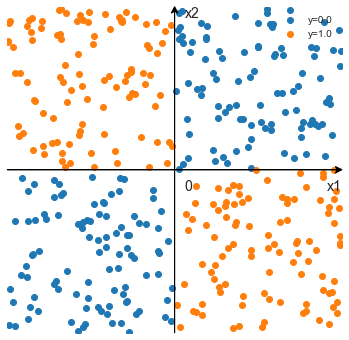

In [57]:
from support import make_xor_dataset

X, y = make_xor_dataset(400, r=3.)
plot_dataset_2d(X, y);

Lets try and train a perceptron on this data.

In [58]:
W0 = (-0.5 + np.random.random(size=X.shape[1]))
b0 = (-0.5 + np.random.random(1))

animate_perceptron_training_rule(X, y,  W0, b0, Nsteps=50)

Final Accuracy: 38.75%


As we can see one perceptron is unable to handle this type of data. One of the ways we can actualy solve it is *feature engineering*.

### Adding new features

We can help the model separate the data more efficiently by adding more features to the existing ones. You can square, multiply, or even take a sin() - any non-linear combination of existing features would do the trick. **Question:** Why are we adding only non-linear combination of features?

In [59]:
# DIY: Create a new feature in the next cell
def add_feature(X):
    #---YOUR CODE HERE---#
    # Hint: Try squaring, multiplying, dividing, sin() or combination
    # Example:
#     Z = np.expand_dims(X[:, 0], axis=1) # Example of duplicating the first feature
#     X = np.concatenate((X, Z), axis=1)
    Z = ...
    X = ...
    return X

X_extra_features = add_feature(X)

print(f"X has {X_extra_features.shape[1]} features.")

X has 3 features.


In [60]:
# Since we have more features the weights vector should also be adjusted
W0 = (-0.5 + np.random.random(size=X_extra_features.shape[1]))
b0 = (-0.5 + np.random.random(1))

# Note: we need to pass add_feature() to the animation_perceptron_learning function
animate_perceptron_training_rule(
    X_extra_features, y, W0, b0,
    Nsteps=200, Nskip=1, learning_rate=0.02, add_feature=add_feature)

Final Accuracy: 55.00000000000001%


By adding the multiplication of the two features, we can solve the *XOR* problem. However, in reality, feature engineering is an error-prone process. You can try adding other features by modifying the `add_features()` function

## Circle data
This is another example of the data that can't be linearly separated. However, we know the trick of adding new features.

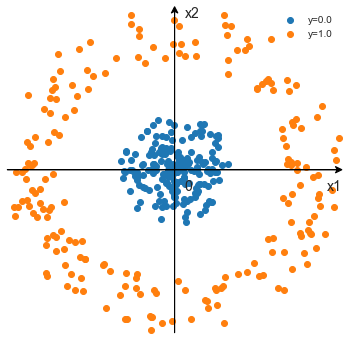

In [61]:
from support import make_circle_dataset

X, y = make_circle_dataset(400, r=3.)
plot_dataset_2d(X, y);

In [62]:
W0 = (-0.5 + np.random.random(size=X.shape[1]))
b0 = (-0.5 + np.random.random(1))

animate_perceptron_training_rule(X, y, W0, b0, Nsteps=100, Nskip=10)

Final Accuracy: 44.0%


In [68]:
# DIY: add a new feature that will help perceptron to solve this dataset
# Remember any non-linear combination might work, but concentrate on this specific dataset
# What features would be suitable for classifing the datapoints in the middle?
def add_feature(X):
    #---YOUR CODE HERE---#
    Z = ...
    X = ...
    return X

X_extra_features_1 = add_feature(X)

print(f"X has {X_extra_features_1.shape[1]} features.")

X has 3 features.


In [69]:
W0 = (-0.5 + np.random.random(size=X_extra_features_1.shape[1]))
b0 = (-0.5 + np.random.random(1))

# Note: we need to pass add_feature() to the animation_perceptron_learning function
animate_perceptron_training_rule(
    X_extra_features_1, y,  W0, b0,
    learning_rate=0.01, Nsteps=100, Nskip=10, add_feature=add_feature)

Final Accuracy: 97.25%


# Gradient Descent and Delta Rule

The Perceptron Training Rule was one of the first rules to train the parameters of a perceptron. The perceptron parameters only converge if the data set $D$ is linearly separable (see [Machine Learning, Tom Mitchel, 1997](http://www.cs.cmu.edu/~tom/mlbook.html), section 4.4.3). To overcome this problem, another training rule called the **delta rule** was developed. This rule **will always converge to the best possible values**. It does not mean that it will always be correct, but this means that it will do the best given the *features* and its *capacity*.

The basis of the delta rule is to apply gradient descent on the total training error function. The total training error is defined by:

$$
E = \frac{1}{2} \sum_{j=1}^N e_j^2
$$

with

$$e_j = y_j - \hat{y}_j$$

$$\hat{y}_j = f(z_j)$$

$$z_j = \mathbf {x} \cdot \mathbf {w} + b $$

During each training iteration the perceptron weight vector and bias are adjusted by the following update rule:

$$
\mathbf{w} \leftarrow \mathbf{w} + \Delta \mathbf{w}
$$
$$
b \leftarrow b + \Delta b
$$

with 

$$
\Delta \mathbf{w} = -\eta \frac{\partial E}{\partial \mathbf{w}}
$$

$$
\Delta b = -\eta \frac{\partial E}{\partial b}
$$

The gradient of the total training error $E$ with respect to the weight vector and bias can be derived using the *chain rule*.

$$
\frac{\partial E}{\partial \mathbf{w}} = -\sum_{j=1}^N e_j \frac{\partial f(z_i)}{\partial z_i} \mathbf{x}_j
$$

$$
\frac{\partial E}{\partial b} = -\sum_{j=1}^N e_j \frac{\partial f(z_j)}{\partial z_j}
$$

The Perceptron Delta Rule requires to calculate the derivative of the activation function. This means that the activation function must be differentiable. The **threshold function is not differentiable**. Therefore, as an alternative *sigmoid* function is used as an activation function for the perceptron. Have a look at the plot of a sigmoid function, it really looks like a smooth threshold function.

In [70]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def grad_sigmoid(z):
    s = sigmoid(z)
    return s * (1 - s)

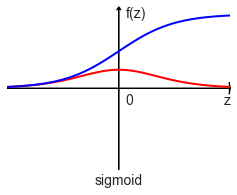

In [71]:
from support import plot_activation_function

fig, ax = plt.subplots(1, 1, figsize=(4, 3))
plot_activation_function(sigmoid, grad_sigmoid, name='sigmoid', ax=ax, labels=('z', 'f(z)'), xlim=(-4, 4), ylim=(-1.1, 1.1))

In [83]:
# Perceptron rule stays the same
# DIY: implement percetron delta training rule
def perceptron_delta_rule(W, b, y, y_pred, X, learning_rate, grad_f):
    #---YOUR CODE HERE---#
    # Hint: use equations defined before
    
    # Calculate error
    e = ...
    # perform a forward path without sigmoid
    z = ...
    # take a gradient of sigmoid with respect to weights. Hint: use grad_f
    df = ...
    # take the gradient of the error function with respect to weights. Hint: use chain rule
    # add an extra dimension before multiplying by X with array[:, np.newaxis], since X has shape (1, n_features)
    dEdw = ...
    # take the gradient of the error function with respect to biases
    dEdb = ...
    # update weights
    W = ...
    # update biases
    b = ...

    return W, b

In [94]:
W0 = (-0.5 + np.random.random(size=X.shape[1]))
b0 = (-0.5 + np.random.random(1))

# permute the ids of the dataset
sample_idxs = np.random.permutation(X.shape[0])

# iterate over each element
for idx in sample_idxs:
    # select a random point
    x = X[idx,:]            

    # predict output
    y_pred = perceptron(x, W0, b0, threshold_fn)

    # update weights
    W0, b0 = perceptron_delta_rule(W0, b0, y[idx], y_pred, x, learning_rate, grad_sigmoid)

# Make prediction on the whole dataset
final_y_pred = perceptron(X, W0, b0, sigmoid)
# Since the output of a sigmoind is float between [0, 1] you would need to round your predictions
final_y_pred = np.round(final_y_pred)

# If the accuracy is above 50 percent the rule is working
print("Final Accuracy: {}%".format(binary_accuracy(y, final_y_pred) * 100))

# you can re-run this cell if the rule did not converge

Final Accuracy: 61.75000000000001%


In [98]:
import matplotlib.animation as animation
import matplotlib.pyplot as plt
from IPython.display import HTML

def animate_perceptron_delta_rule(X, 
                                  y, 
                                  W0, 
                                  b0, 
                                  activation=sigmoid, 
                                  grad_activation=grad_sigmoid,
                                  learning_rate=0.01, 
                                  Nepochs=20, 
                                  figsize=(6, 6), 
                                  add_feature=None):
    """Create animation of perrceptron delta rule."""    
    global W, b
    
    fig, ax = plt.subplots(figsize=figsize)
    plt.close() # remove additional plot shown in Jupyter

    # calculate min/max value of data for plotting
    x1_min, x2_min = -np.abs(X[:,0]).max(), -np.abs(X[:,1]).max()
    x1_max, x2_max = np.abs(X[:,0]).max(), np.abs(X[:,1]).max()
    
    # prepare background decision boundary image
    xx1 = np.linspace(x1_min, x1_max, 50)
    xx2 = np.linspace(x2_min, x2_max, 50)
    xx1, xx2 = np.meshgrid(xx1, xx2)
    x1x2 = np.concatenate((xx1.ravel().reshape(-1, 1), xx2.ravel().reshape(-1, 1)), axis=1)
    if X.shape[1]>2:
        x1x2 = add_feature(x1x2)

    # plot background boundary image
    z = perceptron(x1x2, W0, b0, activation).reshape(xx1.shape)
    im = ax.imshow(z[::-1, :], zorder=0, extent=[x1_min, x1_max, x2_min, x2_max], cmap='coolwarm', alpha=0.25, interpolation='bilinear')    

    # plot dataset
    plot_dataset_2d(X[:,:2], y, 
                    x1lim=(x1_min, x1_max),
                    x2lim=(x2_min, x2_max),                    
                    ax=ax, 
                    title=f'Perceptron Delta Rule (inputs={X.shape[1]}, lr={learning_rate})',
                    fontsize=16,
                    show_legend=False)    
    
    # prepare hyperplane line
    line, = ax.plot([], [], linewidth=4, marker='o', markersize=0, c='r', animated=True)

        # Make prediction on the whole dataset
    final_y_pred = perceptron(X, W0, b0, threshold_fn)
    # Since the output of a sigmoind is float between [0, 1] you would need to round your predictions
    final_y_pred = np.round(final_y_pred)

    # If the accuracy is above 50 percent the rule is working
    print("Final Accuracy: {}%".format(binary_accuracy(y, final_y_pred) * 100))
    
    def init():
        global W, b
        
        # initialize parameters perceptron
        W = W0
        b = b0
        
        # set background image
        z = perceptron(x1x2, W, b, activation).reshape(xx1.shape)
        im.set_array(z[::-1, :])

        # draw hyperplane
        line.set_data([], [])
        return line,
    
    def animate(i):
        global W, b            
        # predict output
        y_pred = perceptron(X, W, b, activation)

        # update weights
        W, b = perceptron_delta_rule(W, b, y, y_pred, X, learning_rate, grad_activation)
            
        # plot background decision boundary image
        # set background image
        z = perceptron(x1x2, W, b, activation).reshape(xx1.shape)
        im.set_array(z[::-1, :])

        # draw hyperplane
        if X.shape[1] == 2:
            x1 = np.array([x1_min, x1_max])
            x2 = (W[0] * x1 + b) / -W[1]
            line.set_data(x1, x2)
        
        return line,

    ani = animation.FuncAnimation(fig, animate, init_func=init, 
                                  interval=100, blit=True, save_count=Nepochs)

    return HTML(ani.to_jshtml())

In [107]:
W0 = (-0.5 + np.random.random(size=X.shape[1]))
b0 = (-0.5 + np.random.random(1))

# Note: we need to pass add_feature() to the animation_perceptron_learning function
animate_perceptron_delta_rule(X, y,  W0, b0, Nepochs=100, learning_rate=0.01)

Final Accuracy: 59.75%


Notice that even though it has converged, the accuracy is a not very good.

In [109]:
# DIY: add a new feature that will help perceptron to solve this dataset
# Remember any non-linear combination might work, but concentrate on this specific dataset
# What features would be suitable for classifing the datapoints in the middle?
def add_feature(X):
    #---YOUR CODE HERE---#
    # Hint: reuse features defined earlier
    Z = ...
    X = ...
    return X

X_extra_features_1 = add_feature(X)

print(f"X has {X_extra_features_1.shape[1]} features.")

W0 = (-0.5 + np.random.random(size=X_extra_features_1.shape[1]))
b0 = (-0.5 + np.random.random(1))

# Note: we need to pass add_feature() to the animation_perceptron_learning function
animate_perceptron_delta_rule(X_extra_features_1, y,  W0, b0, Nepochs=50, learning_rate=0.1, add_feature=add_feature)

X has 3 features.
Final Accuracy: 88.25%


# Next Steps
Although the perceptron is the most straightforward neural network there is, it already has practical applications. Experiment with new data sets (generate new sets see: https://scikit-learn.org/stable/modules/classes.html#module-sklearn.datasets) and see how a perceptron handles this.

In the last part of this chapter, we showed that a perceptron can solve specific problems by using better features. This is generally true. The success of a machine learning model often depends on the selected features. Even if a feature contains all information, a different representation can still allow a model to converge faster or better to an optimal solution.